# Audio Format Conversions


## References

torchaudio [API](https://pytorch.org/audio/stable/index.html)

Neuromatch Project Template [Spectrogram Analysis](https://deeplearning.neuromatch.io/projects/ComputerVision/spectrogram_analysis.html)

Neuromatch [Collab Notebook](https://colab.research.google.com/github/NeuromatchAcademy/course-content-dl/blob/main/projects/ComputerVision/spectrogram_analysis.ipynb) for Genre Classification



In [ ]:
# @title Install dependencies
!sudo apt-get install -y ffmpeg --quiet
!pip install librosa --quiet
!pip install torchaudio --quiet
!pip install imageio --quiet
!pip install imageio-ffmpeg --quiet

In [1]:
import torch
import torch.nn as nn
import torchaudio
from tqdm.notebook import tqdm
import numpy as np
import matplotlib.pyplot as plt
from IPython.display import display, Audio
import librosa
import librosa.display
import os


print(torch.__version__)
print(torchaudio.__version__)

# Set this to the location of the data directory in google drive, or wherever you want to download your data
#datapath = "/content/" # collab vm download path

# replace with the location of the data folder on google drive
datapath = "/content/drive/MyDrive/LEVERHULME/COURSES/NEUROMATCH2021/HallucinatingGANs/Code/data/"

# running locally (comment this line out if you are running on collab)
datapath = "./data"

print("Looking for data at", datapath)


1.9.0
0.9.0a0+33b2469
Looking for data at ./data


# Get the GTZAN Dataset

## Option 1. Download the dataset from Neuromatch (this one includes MEL spectrogram images)

In [ ]:
# Download the GTZAN dataset manually if you need to
# Otherwise you can find the unzipped dataset in our google drive folder under Code/data/gztan/
import requests

fname = os.path.join(datapath, 'gztan_download.zip')
url = "https://osf.io/drjhb/download"

if not os.path.isfile(fname):
  try:
    r = requests.get(url)
  except requests.ConnectionError:
    print("!!! Failed to download data !!!")
  else:
    if r.status_code != requests.codes.ok:
      print("!!! Failed to download data !!!")
    else:
      with open(fname, "wb") as fid:
        fid.write(r.content)

In [ ]:
# Unzip the dataset if you downloaded it
from zipfile import ZipFile

with ZipFile(fname, 'r') as zipObj:
  # Extract all the contents of zip file in different directory
  zipObj.extractall()

## Option 2. Get GZTAN directly from torchaudio.datasets

In [2]:
# Another option: get the gztan dataset directly from torchaudio

gztan = torchaudio.datasets.GTZAN(os.path.abspath(datapath), download=False)

In [3]:
# Get the first audio sample from gztan
waveform, samplerate, label = gztan[0]
num_chan, num_frames = waveform.shape
print(f'Index {0} - {label}')
print(f' - Samplerate:  {samplerate}')
print(f' - Dtype:       {waveform.dtype}')
print(f' - Channels:    {num_chan}')
print(f' - NumFrames:   {num_frames}')
print(f' - Duration:    {(waveform.shape[1] / samplerate):.2f}s')
print(f" - Max:         {waveform.max().item():.3f}")
print(f" - Min:         {waveform.min().item():.3f}")
print(f" - Mean:        {waveform.mean().item():.3f}")
print(f" - Std Dev:     {waveform.std().item():.3f}")



Index 0 - blues
 - Samplerate:  22050
 - Dtype:       torch.float32
 - Channels:    1
 - NumFrames:   661794
 - Duration:    30.01s
 - Max:         0.885
 - Min:         -0.840
 - Mean:        -0.000
 - Std Dev:     0.141


# Looking at / Listening to the Data

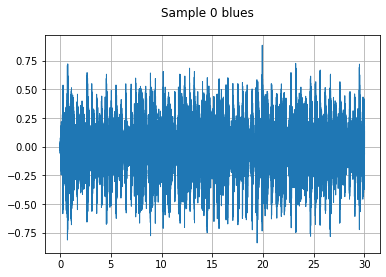

In [8]:
# Plot the waveform

def plot_waveform(waveform, sample_rate, title="Waveform", xlim=None, ylim=None):
  waveform = waveform.numpy()
  num_channels, num_frames = waveform.shape
  time_axis = torch.arange(0, num_frames) / sample_rate

  figure, axes = plt.subplots(num_channels, 1)
  if num_channels == 1:
    axes = [axes]
  for c in range(num_channels):
    axes[c].plot(time_axis, waveform[c], linewidth=1)
    axes[c].grid(True)
    if num_channels > 1:
      axes[c].set_ylabel(f'Channel {c+1}')
    if xlim:
      axes[c].set_xlim(xlim)
    if ylim:
      axes[c].set_ylim(ylim)
  figure.suptitle(title)
  plt.show(block=False)

plot_waveform(waveform, samplerate, f"Sample 0 {label}")

In [64]:
def play_audio(waveform, samplerate):
  if type(waveform) == torch.Tensor:
      waveform = waveform.numpy()

  num_channels, num_frames = waveform.shape
  if num_channels == 1:
    display(Audio(data=waveform, rate=samplerate))
  elif num_channels == 2:
    display(Audio(data=(waveform[0], waveform[1]), rate=samplerate))
  else:
    raise ValueError("Waveform with more than 2 channels are not supported.")


play_audio(waveform, samplerate)

spectrogram shape: torch.Size([1, 513, 2586])  dtype: torch.float32
mel spectrogram shape: torch.Size([1, 128, 2586])  dtype: torch.float32


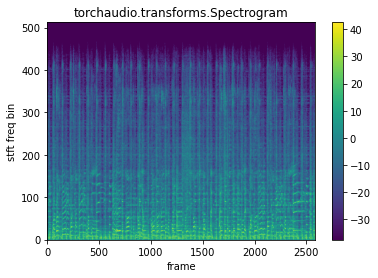

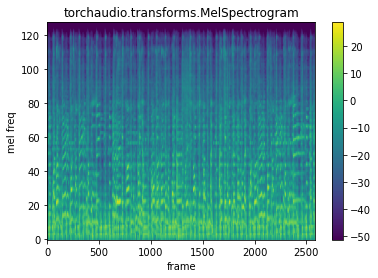

In [86]:
# Compute Spectrograms using torchaudio Transforms

def plot_spectrogram(spec, title=None, ylabel='freq_bin', aspect='auto', xmax=None):
  fig, axs = plt.subplots(1, 1)
  axs.set_title(title or 'Spectrogram (db)')
  axs.set_ylabel(ylabel)
  axs.set_xlabel('frame')
  im = axs.imshow(librosa.power_to_db(spec), origin='lower', aspect=aspect)
  if xmax:
    axs.set_xlim((0, xmax))
  fig.colorbar(im, ax=axs)
  plt.show(block=False)


n_fft = 1024
n_mels = 128
win_length = None
hop_length = 256 # smaller hop size leads to better reconstruction but takes longer to compute
power = 2.0 # squared power spectrogram

get_spec = torchaudio.transforms.Spectrogram(
    n_fft=n_fft,
    win_length=win_length,
    hop_length=hop_length,
    center=True,
    pad_mode="reflect",
    power=power,
)
spec = get_spec(waveform)
print(f"spectrogram shape: {spec.shape}  dtype: {spec.dtype}")


get_melspec = torchaudio.transforms.MelSpectrogram(
    sample_rate=samplerate,
    n_fft=n_fft,
    win_length=win_length,
    hop_length=hop_length,
    center=True,
    pad_mode="reflect",
    power=power,
    norm='slaney',
    onesided=True,
    n_mels=n_mels,
    mel_scale="htk",
)
melspec = get_melspec(waveform)
print(f"mel spectrogram shape: {melspec.shape}  dtype: {melspec.dtype}")

plot_spectrogram(spec[0], title="torchaudio.transforms.Spectrogram", ylabel='stft freq bin')

plot_spectrogram(melspec[0], title="torchaudio.transforms.MelSpectrogram", ylabel='mel freq')


1024 torch.Size([1, 513, 2586])


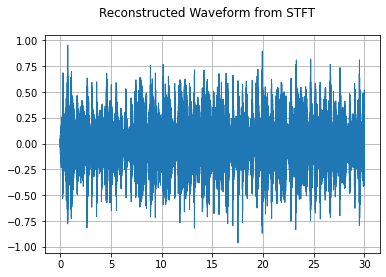

In [84]:
# Resynthesize audio from spectrogram using Griffin-Lim phase reconstruction

torch.random.manual_seed(0)

resynth_griffin_lim = torchaudio.transforms.GriffinLim(
    n_fft=n_fft,
    win_length=win_length,
    hop_length=hop_length,
)

print(n_fft, spec.shape)

resynthesized_waveform = resynth_griffin_lim(spec)

plot_waveform(resynthesized_waveform, samplerate, title="Reconstructed Waveform from STFT")

play_audio(resynthesized_waveform, samplerate)

In [31]:
# Try to reconstruct stft from Mel spectrogram... 
# this can take a very long time, sometimes it doesn't seem to converge at all

n_stft = int(n_fft/2) + 1
tolerance_loss = 1e-02
tolerance_loss = 5.0

inverse_mel_scale = torchaudio.transforms.InverseMelScale(
    n_stft=n_stft, 
    n_mels=n_mels, 
    sample_rate=samplerate,
    tolerance_loss=tolerance_loss
)
stft_audio = inverse_mel_scale(melspec)
print(stft_audio.shape)
print(stft_audio)


torch.Size([1, 513, 2586])
tensor([[[ 0.0696,  0.3030,  0.6703,  ...,  0.1402,  0.8554,  0.5841],
         [ 2.0176,  0.4476,  0.3805,  ...,  0.2387,  7.5591, 15.1980],
         [ 1.0718,  1.4947,  1.3450,  ...,  4.9595, 16.9834,  0.9861],
         ...,
         [ 0.1518,  0.0541,  0.2603,  ...,  0.1462,  0.1341,  0.1377],
         [ 0.4588,  0.0781,  0.4585,  ...,  0.4042,  0.2398,  0.5988],
         [ 0.1645,  0.4678,  0.7363,  ...,  0.7281,  0.2867,  0.9500]]])


torch.Size([1, 513, 2586])


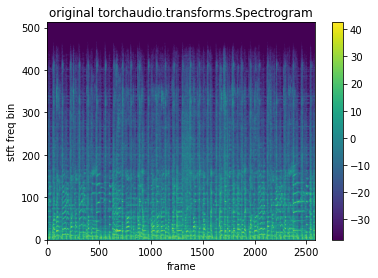

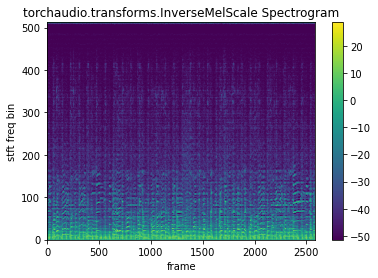

Original Audio


Resynthesis from STFT


Resynthesis from Mel Spectrogram


In [89]:
print(stft_audio.shape)

resynth_from_mel = torchaudio.transforms.GriffinLim(
    n_fft=n_fft,
    win_length=win_length,
    hop_length=hop_length,
)

resynthesis_stft = resynth_griffin_lim(spec)
resynthesis_mel = resynth_from_mel(stft_audio[0]).unsqueeze(dim=0)

plot_spectrogram(spec[0], title="original torchaudio.transforms.Spectrogram", ylabel='stft freq bin')
plot_spectrogram(stft_audio[0], title="torchaudio.transforms.InverseMelScale Spectrogram", ylabel='stft freq bin')

print("Original Audio")
play_audio(waveform, samplerate)
print("Resynthesis from STFT")
play_audio(resynthesis_stft, samplerate)
print("Resynthesis from Mel Spectrogram")
play_audio(resynthesis_mel, samplerate)



## Using librosa

See the [librosa api documentation](https://librosa.org/doc/latest/core.html)

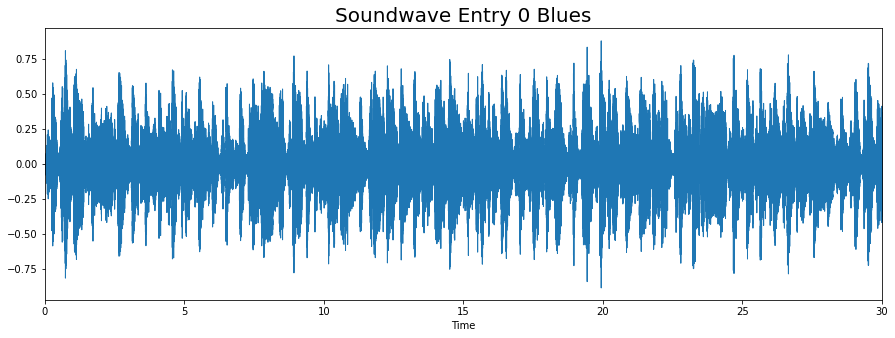

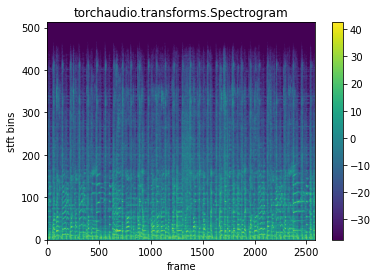

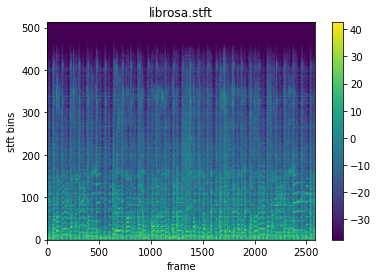

Mean Square Difference:  1.3934330078679835e-10


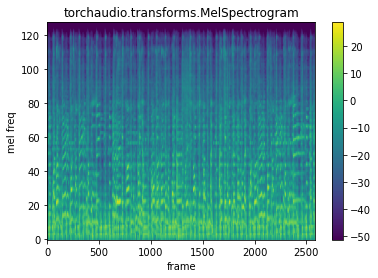

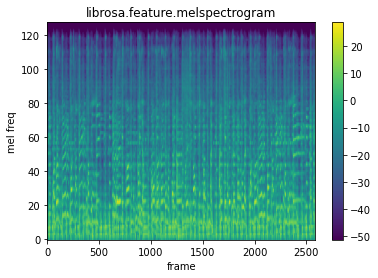

Mean Square Difference:  1.3779200003227743e-10


In [90]:
# librosa works with numpy arrays >> convert pytorch tensor to numpy array 
npwavform = waveform.numpy()[0]

# alternatively, load an audio file from disk
filepath = os.path.join(os.path.abspath(datapath), "gztan_nma/genres_original/blues/blues.00000.wav")
librosa_waveform = librosa.load(filepath)


plt.figure(figsize=(15, 5))
librosa.display.waveplot(y=npwavform, sr=samplerate);
plt.title("Soundwave Entry 0 Blues", fontsize=20)
plt.show()

spec_librosa_raw = librosa.stft(
    npwavform,
    n_fft=n_fft,
    hop_length=hop_length,
    win_length=win_length
) 

# get squared power magnitude spectrum
spec_librosa = np.abs(spec_librosa_raw)**2

melspec_librosa = librosa.feature.melspectrogram(
    npwavform,
    sr=samplerate,
    n_fft=n_fft,
    hop_length=hop_length,
    win_length=win_length,
    center=True,
    pad_mode="reflect",
    power=2.0,
    n_mels=n_mels,
    norm='slaney',
    htk=True,
)

plot_spectrogram(spec[0], title="torchaudio.transforms.Spectrogram", ylabel='stft bins')
plot_spectrogram(spec_librosa, title="librosa.stft", ylabel='stft bins')
mse = torch.square(spec - spec_librosa).mean().item()
print('Mean Square Difference: ', mse)

plot_spectrogram(melspec[0], title="torchaudio.transforms.MelSpectrogram", ylabel='mel freq')
plot_spectrogram(melspec_librosa, title="librosa.feature.melspectrogram", ylabel='mel freq')
mse = torch.square(melspec - melspec_librosa).mean().item()
print('Mean Square Difference: ', mse)

In [55]:
# Converting back to audio

resynth_lr_spec = librosa.griffinlim(
    spec_librosa,
    hop_length=hop_length,
    win_length=win_length,
)

# This resynthesis can take an especially long time...
resynth_lr_mel = librosa.feature.inverse.mel_to_audio(
    melspec_librosa,
    sr=samplerate,
    n_fft=n_fft,
)

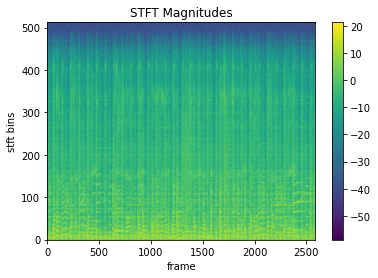

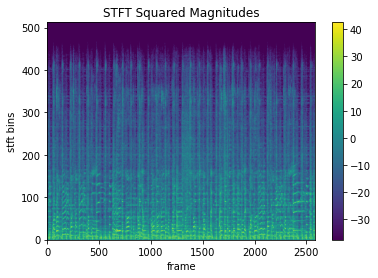

(661760,) (661760,) <class 'numpy.ndarray'> [-0.07306935 -0.07399257 -0.07031766 ...  0.16305825  0.16584973
  0.16215664]
librosa Resynthesis from iSTFT with phase


librosa Resynthesis from STFT Magnitudes - Griffin Lim


librosa Resynthesis from STFT Squared Magnitudes - Griffin Lim


In [105]:
speclr_raw = librosa.stft(
    npwavform,
    n_fft=n_fft,
    hop_length=hop_length,
    win_length=win_length
) 

# Remove complex valued phase information & squared power
speclr_mag = np.abs(speclr_raw)
speclr_mag2 = speclr_mag**2

# Should provide very good resynthesis
resynth_inv = librosa.istft(
    speclr,
    hop_length=hop_length,
    win_length=win_length,
)

# Approximating resynthesis from magnitudes
resynth_gl = librosa.griffinlim(
    speclr_mag,
    hop_length=hop_length,
    win_length=win_length,
    momentum=0.9,
    init='random'
)

resynth_gl2 = librosa.griffinlim(
    np.sqrt(speclr_mag2),
    hop_length=hop_length,
    win_length=win_length,
    momentum=0.9,
    init='random'
)

plot_spectrogram(speclr_mag, title="STFT Magnitudes", ylabel='stft bins')
plot_spectrogram(speclr_mag2, title="STFT Squared Magnitudes", ylabel='stft bins')

print(resynth_gl.shape, resynth_gl2.shape, type(resynth_gl2), resynth_gl2)

print("librosa Resynthesis from iSTFT with phase")
play_audio(np.expand_dims(resynth_inv, 0), samplerate)

print("librosa Resynthesis from STFT Magnitudes - Griffin Lim")
play_audio(np.expand_dims(resynth_gl, 0), samplerate)

print("librosa Resynthesis from STFT Squared Magnitudes - Griffin Lim")
play_audio(np.expand_dims(resynth_gl2, 0), samplerate)


In [70]:
print("Original Audio")
play_audio(waveform, samplerate)

print("torchaudio Resynthesis from STFT")
play_audio(resynthesis_stft, samplerate)

print("torchaudio Resynthesis from Mel Spectrogram")
play_audio(resynthesis_mel, samplerate)

print("librosa Resynthesis from STFT")
play_audio(np.expand_dims(resynth_lr_spec, 0), samplerate)

print("librosa Resynthesis from Mel Spectrogram")
play_audio(np.expand_dims(resynth_lr_mel, 0), samplerate)




Original Audio


torchaudio Resynthesis from STFT


torchaudio Resynthesis from Mel Spectrogram


librosa Resynthesis from STFT


librosa Resynthesis from Mel Spectrogram


In [130]:
numpy.uint8

NameError: name 'numpy' is not defined

In [ ]:
import skimage.io

#Rescale to 0-255 and convert to uint8
#rescaled = (255.0 / data.max() * (data - data.min())).astype(np.uint8)

#im = Image.fromarray(rescaled)
#im.save('test.png')

# TODO: Look into other scaling possibilities, converting between float and uint8 is very lossy!
#       is there a better way?
def scale_minmax(X, min=0.0, max=1.0):
    X_std = (X - X.min()) / (X.max() - X.min())
    X_scaled = X_std * (max - min) + min
    return X_scaled


src_path = 'gztan_nma/genres_original' # dataset audio files directory
dst_path = 'gztan_sq_stft' # where to write images

OVERWRITE = False
TEST_RUN = False # test to see output, only write first file of each genre
test_path = 'gztan_sq_stft_test' # directory to write test outputs

src_path = os.path.join(os.path.abspath(datapath), src_path)

if TEST_RUN:
    dst_path = os.path.join(os.path.abspath(datapath), test_path)
else:
    dst_path = os.path.join(os.path.abspath(datapath), dst_path)

    
print("Test Run: ", TEST_RUN)
print("Source path: ", src_path)
print("Dest path: ", dst_path)

if not os.path.exists(dst_path):
    os.mkdir(dst_path)


for genre in os.listdir(src_path
    print("Genre: ", genre)
    current_src_dir = os.path.join(src_path, genre)
    current_dst_dir = os.path.join(dst_path, genre)
    if not os.path.exists(current_dst_dir):
        os.mkdir(current_dst_dir)
    for i, wav_filename in enumerate(os.listdir(current_src_dir)):
                
        if TEST_RUN and i != 0:
            continue

        png_filename = os.path.splitext(wav_filename)[0] + '.png'
        src_file = os.path.join(current_src_dir, wav_filename)
        dst_file = os.path.join(current_dst_dir, png_filename)
                
        if not OVERWRITE and os.path.exists(dst_file) and not TEST_RUN:
            print("Skipping existing file ", dst_file)
            continue
            
        # 1. load wav file
        wave, sr = librosa.load(src_file, mono=True)
        
        # 2. generate squared power spectrogram
        # TODO: is squared power necessary? converting to uint8 already loses a lot of nuance
        spectro = np.abs(librosa.stft(
            wave,
            n_fft=n_fft,
            hop_length=hop_length,
            win_length=win_length,
        ))#**2 remove for now...
                        

        # 3. save as png
        
        # TODO: experiment with logscale ... possibly a good data augmentation strategy?
        #logscale = numpy.log(spectro + 1e-9) # add small number to avoid log(0)

        # scale to 8-bit range
        scaled = (255.0 / spectro.max() * (spectro - spectro.min())).astype(np.uint8)
        img = np.flip(scaled, axis=0) # put low frequencies at the bottom in image to make more human-readable
        img = 255-img # invert. make black==more energy

        # save as PNG
        skimage.io.imsave(dst_file, img)
        print("Writing ", dst_file)


# Plot last saved spectrogram
plot_spectrogram(spectro, title="Raw", ylabel='stft bins')
plot_spectrogram(scaled, title="Scaled", ylabel='stft bins')



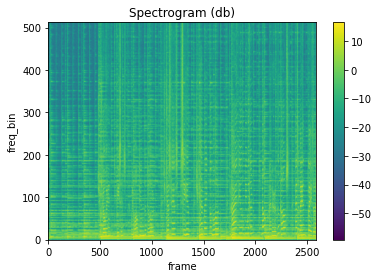

Raw Image
Raw Image Visualized as Spectrogram


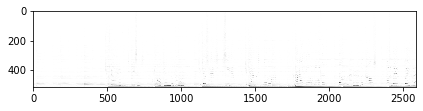

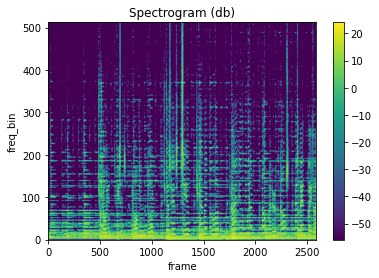

Original


Reconstructed Audio from Image using Griffin Lim


In [167]:
# Resynthesize from stft spectrogram images
# TODO: Try and do the same with mel spectrograms
wv, sr = librosa.load(savedinfile)
stft = librosa.stft(wv, n_fft=1024)

plot_spectrogram(np.abs(stft))

img = skimage.io.imread(savedoutfile)
print("Raw Image")
skimage.io.imshow(img)

# TODO: There must be a better way to convert back to the original range of the spectrograms than just to cast as float?
recovered_spectrogram = np.flip(255-img, axis=0).astype(np.float32)

print("Raw Image Visualized as Spectrogram")
plot_spectrogram(recovered_spectrogram)

recovered_audio = librosa.griffinlim(
    recovered_spectrogram,
    hop_length=hop_length,
    win_length=win_length,
    momentum=0.9,
    init='random'
)

print("Original")
play_audio(np.expand_dims(wv,0), sr)

print("Reconstructed Audio from Image using Griffin Lim")
play_audio(np.expand_dims(recovered_audio,0), sr)



(tensor([[ 0.0073,  0.0166,  0.0076,  ..., -0.0556, -0.0611, -0.0642]]),
 22050,
 'blues')